In [87]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly.colors as pc

#### Load Data

In [88]:
subjects = pd.read_csv("data/treadmill/subject-info.csv")
measures = pd.read_csv("data/treadmill/test_measure.csv")

subjects = subjects.sort_values(by=["ID_test"])
measures = measures.sort_values(by=["ID_test", "time"])

measures["O2_rate"] = measures["VO2"]
measures["CO2_rate"] = measures["VCO2"]
measures["air_rate"] = measures["VE"]

measures["O2_vol"] = measures["O2_rate"] / measures["RR"]
measures["CO2_vol"] = measures["CO2_rate"] / measures["RR"]
measures["air_vol"] = measures["air_rate"] / measures["RR"]

measures["O2_cum"] = measures.groupby("ID_test")["O2_vol"].cumsum()
measures["CO2_cum"] = measures.groupby("ID_test")["CO2_vol"].cumsum()
measures["air_cum"] = measures.groupby("ID_test")["air_vol"].cumsum()

measures = measures.drop(columns=["VO2", "VCO2", "VE"])

# Define numerical features
measures_numerical = {'time', 'Speed', 'HR', 'RR', 'O2_rate', 'CO2_rate',
       'air_rate', 'O2_vol', 'CO2_vol', 'air_vol', 'O2_cum', 'CO2_cum',
       'air_cum', 'Age', 'Weight', 'Height', 'Humidity', 'Temperature'}

#### Normalizes start times to zero

Each test starts at approximately 5km/hr and increases at a rate of 60 km/hr^2

In [89]:
# Normalizes the start times of the test from start speed of 5 km/h
measures_test = measures[measures["Speed"] > 5]
normal_starts = measures_test.groupby("ID_test")["time"].transform("first")
measures_test.loc[:,"time"] = measures_test["time"] - normal_starts

# Normalizes the start times of the test from start speed of 6.1 km/h
ids_slow = measures_test[(measures_test["Speed"]==6.1) &(measures_test["time"]>100)]["ID_test"].unique()
first_steps = measures_test[measures_test["ID_test"].isin(ids_slow) & (measures_test["Speed"] > 6.1)].groupby("ID_test")["time"].first()
measures_test.loc[:,"time"] = measures_test["time"] - measures["ID_test"].map(first_steps).fillna(0) + 60
measures_test = measures_test[measures_test["time"] > 0]

# Remove tests with non-standard speeds increase rates
outlier_ids = list(measures_test[(measures_test["time"].between(276,301)) & (measures_test["Speed"] > 11.4)]["ID_test"].unique())
outlier_ids += ["715_1", "796_1", "593_1", "789_1", "479_1", "73_1", "667_1", "318_1", "376_1", "695_1"]
measures_test = measures_test[(measures_test["time"] > 0) & (~measures_test["ID_test"].isin(outlier_ids))]

# Remove cooldown periods
measures_test = measures_test[~((measures_test["time"] > 600) & (measures_test["Speed"] < 12))]

# Start all tests at time 0
measures_test.loc[:,"time"] = measures_test["time"] - measures_test.groupby("ID_test")["time"].transform("min")

#### Interpolate observations to one per second

In [90]:
df = measures_test.groupby(["ID_test", "time"]).mean()
max_secs = measures_test.groupby("ID_test")["time"].agg("max")
tuples = [(key, second) for key, value in max_secs.items() for second in range(value + 1)]
index = pd.MultiIndex.from_tuples(tuples, names=["ID_test", "time"])
measures_test = df.reindex(index).interpolate(method="linear", limit_direction="both").reset_index()
measures_test.loc[:, "ID"] = measures_test["ID"].astype("int")

# Join with subjects
measures_test = measures_test.merge(subjects, on=["ID_test", "ID"], how="left")

# Compute max speed attained quintile
measures_test["max_speed_quintile"] = measures_test["ID_test"].map(pd.qcut(measures_test.groupby("ID_test")["time"].max(), 5, labels=False))

#### Generate Color Scale

In [91]:
# Generate color scale based on max speed attained
color_data = measures_test.groupby("ID_test")["Speed"].max()

hover_texts = [f"Max Treadmill Speed: {d:.2f}" for d in color_data]

n_bins = 5
bin_ids = pd.qcut(color_data, q=n_bins, labels=False, duplicates='drop')

colorscale = pc.get_colorscale('bluered')
discrete_colors = pc.sample_colorscale(colorscale, [i / (n_bins - 1) for i in range(n_bins)])

colors = [discrete_colors[b] for b in bin_ids]

#### Plots

In [482]:
# Plot O2 Exchange Efficiency - Percent of O2 consumed by the body in each breath
fig = go.Figure()

for i, test in enumerate(measures_test["ID_test"].unique()):

    t1 = measures_test[measures_test["ID_test"]==test]

    fig.add_trace(
        go.Scatter(
            x=t1["time"] / 60,
            y=t1["Speed"],
            #y=t1["O2_vol"].rolling(window=10).mean() / (t1["air_vol"].rolling(window=10).mean() * 1000 * .2095) * 100,
            mode="lines",
            line=dict(color=colors[i], width=.2),
            name=test,
            showlegend=True,
            hovertext=hover_texts[i],
        )
    )

fig.update_layout(
    title = dict(text="O2 Exchange Efficiency in Maximal Treadmill Exercise Test"),
    xaxis=dict(title="Minutes"),
    yaxis=dict(title="O2 Exchange Effficiency (%)"),
    legend=dict(title="ID Test"),
    height= 800,
    width=1000
)

fig.show()

In [92]:
# Same plot as above but grouped by quintile of max speed attained 
fig = go.Figure()

measures_quintiles = measures_test.groupby(["max_speed_quintile", "time"])[list(measures_numerical-{"time"})].mean().reset_index()

for quintile in measures_quintiles["max_speed_quintile"].unique():

    t1 = measures_quintiles[measures_quintiles["max_speed_quintile"]==quintile]

    fig.add_trace(
        go.Scatter(
            x=t1["time"],
            #y=t1["Speed"],
            #y=t1["HR"],
            y=t1["O2_vol"].rolling(window=10).mean() / (t1["air_vol"].rolling(window=20).mean() * 1000 * .2095) * 100,
            #y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            #y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            mode="lines",
            line=dict(color=discrete_colors[quintile], width=2),
            name=f"Quintile {quintile + 1}",
            showlegend=True,
        )
    )

fig.update_layout(
    title = dict(text="O2 Exchange Efficiency in Maximal Treadmill Exercise Test By Quintile of Max Speed Attained"),
    xaxis=dict(title="Seconds on Treadmill"),
    yaxis=dict(title="O2 Exchange Effficiency (%)"),
    legend=dict(title="ID Test"),
    height= 600,
    width=1000
)

fig.show()


In [63]:
# Same plot as above but grouped by quintile of max speed attained 
fig = go.Figure()

measures_quintiles = measures_test.groupby(["max_speed_quintile", "time"])[list(measures_numerical-{"time"})].mean().reset_index()

for quintile in measures_quintiles["max_speed_quintile"].unique():

    t1 = measures_quintiles[measures_quintiles["max_speed_quintile"]==quintile]

    fig.add_trace(
        go.Scatter(
            x=t1["time"],
            #y=t1["Speed"],
            y=t1["HR"],
            #=t1["O2_vol"].rolling(window=20).mean() / (t1["air_vol"].rolling(window=20).mean() * 1000 * .2095) * 100,
            #y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            #y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            mode="lines",
            line=dict(color=discrete_colors[quintile], width=2),
            name=f"Quintile {quintile + 1}",
            showlegend=True,
        )
    )

fig.update_layout(
    title = dict(text="Heart Rates in Maximal Treadmill Exercise Test By Quintile of Max Speed Attained"),
    xaxis=dict(title="Seconds on Treadmill"),
    yaxis=dict(title="Heart Rate (BPM)"),
    legend=dict(title="ID Test"),
    height= 600,
    width=1000
)

fig.show()


In [8]:
# Same plot as above but grouped by quintile of max speed attained 
fig = go.Figure()

measures_quintiles = measures_test.groupby(["max_speed_quintile", "time"])[list(measures_numerical-{"time"})].mean().reset_index()

for quintile in measures_quintiles["max_speed_quintile"].unique():

    t1 = measures_quintiles[measures_quintiles["max_speed_quintile"]==quintile]

    fig.add_trace(
        go.Scatter(
            x=t1["time"],
            #y=t1["Speed"],
            y=t1["RR"],
            #=t1["O2_vol"].rolling(window=20).mean() / (t1["air_vol"].rolling(window=20).mean() * 1000 * .2095) * 100,
            #y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            #y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            mode="lines",
            line=dict(color=discrete_colors[quintile], width=2),
            name=f"Quintile {quintile + 1}",
            showlegend=True,
        )
    )

fig.update_layout(
    title = dict(text="Respiratory Rates in Maximal Treadmill Exercise Test By Quintile of Max Speed Attained"),
    xaxis=dict(title="Seconds on Treadmill"),
    yaxis=dict(title="Respiratory Rate (RPM)"),
    legend=dict(title="ID Test"),
    height= 600,
    width=1000
)

fig.show()

In [105]:
# Same plot as above but grouped by quintile of max speed attained 
fig = go.Figure()

measures_quintiles = measures_test.groupby(["max_speed_quintile", "time"])[list(measures_numerical-{"time"})].mean().reset_index()

for quintile in measures_quintiles["max_speed_quintile"].unique():

    t1 = measures_quintiles[measures_quintiles["max_speed_quintile"]==quintile]

    fig.add_trace(
        go.Scatter(
            x=t1["time"],
            #y=t1["Speed"],
            #y=t1["RR"],
            #=t1["O2_vol"].rolling(window=20).mean() / (t1["air_vol"].rolling(window=20).mean() * 1000 * .2095) * 100,
            y=t1["O2_rate"].rolling(window=10).mean() / t1["Weight"].rolling(window=10).mean(),
            mode="lines",
            line=dict(color=discrete_colors[quintile], width=2),
            name=f"Quintile {quintile + 1}",
            showlegend=True,
        )
    )

fig.update_layout(
    title = dict(text="VO2 Rates in Maximal Treadmill Exercise Test By Quintile of Max Speed Attained"),
    xaxis=dict(title="Seconds on Treadmill"),
    yaxis=dict(title="VO2 Rate (mL/kg/min)"),
    legend=dict(title="ID Test"),
    height= 600,
    width=1000
)

fig.show()

<Axes: >

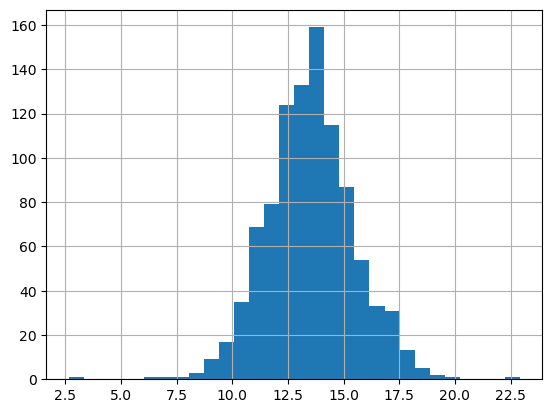

In [10]:
n = 10
last_n_breaths = measures_test.groupby("ID_test").tail(n)[["ID_test", "O2_vol", "air_vol"]].groupby("ID_test").mean()
last_n_breaths_efficiency = (last_n_breaths["O2_vol"] / (last_n_breaths["air_vol"] * 1000 * .2095) * 100).dropna()
last_n_breaths_efficiency.hist(bins=30)

In [11]:
from scipy.stats import shapiro
from scipy.stats import zscore

z = zscore(last_n_breaths_efficiency)
mask = abs(z) < 3  
last_n_breaths_efficiency_no_out = last_n_breaths_efficiency[mask]

stat, p = shapiro(last_n_breaths_efficiency_no_out)
print(f'Shapiro-Wilk normality test:\n')
print(f'T stat = {stat}\np val = {p}\n')

last_n_breaths_efficiency_no_out.describe()

Shapiro-Wilk normality test:

T stat = 0.9974994315929518
p val = 0.1466122721826977



count    967.000000
mean      13.516744
std        1.868894
min        7.972218
25%       12.287831
50%       13.538022
75%       14.688456
max       18.615823
dtype: float64

In [12]:
oxy_eff = last_n_breaths_efficiency_no_out.rename("O2_eff").to_frame().merge(subjects, left_index=True, right_on="ID_test", how="left")
oxy_eff["BMI"] = oxy_eff["Weight"] / (oxy_eff["Height"] / 100) ** 2
cols = ["Age", "Weight", "Height", "Humidity", "Temperature", "BMI"]

for col in cols:
    fig = px.scatter(oxy_eff, x=col, y="O2_eff")
    fig.show()

In [13]:
last_measures = measures_test.groupby("ID_test").last()
x = last_measures["time"]
y = last_measures["RR"]
z = last_measures["Age"]

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x = x,
        y = y,
        mode="markers",
        marker=dict(color=z, colorscale='bluered',showscale=True),
    )
)
fig.update_layout(
    title = dict(text="Last Measures of Treadmill Test"),
    xaxis=dict(title=f"{x.name}"),
    yaxis=dict(title=f"{y.name}"),
    legend=dict(title="ID Test"),
    height= 600,
    width=800
)

fig.show()

In [14]:
def compute_distance(group):
    t = group["time"]
    v = group["Speed"]  # km/h

    dt = t.diff().fillna(0) / 3600  # seconds → hours
    v_avg = v.rolling(2).mean().bfill()  # use .bfill() instead of deprecated method arg

    dist = v_avg * dt  # km
    return dist.cumsum()

# Sort first
measures_test = measures_test.sort_values(["ID_test", "time"])

# Group without including grouping columns in apply
measures_test["dist_km"] = (
    measures_test.groupby("ID_test", group_keys=False)[["time", "Speed"]]
                 .apply(compute_distance)
                 .reset_index(drop=True)
)

In [15]:
measures_test.head(15)

,ID_test,time,Speed,HR,RR,ID,O2_rate,CO2_rate,air_rate,O2_vol,...,CO2_cum,air_cum,Age,Weight,Height,Humidity,Temperature,Sex,max_speed_quintile,dist_km
0,100_1,0,5.100000,92.000000,26.000000,100.0,1083.000000,826.000000,25.10,41.653846,...,1886.615062,59.078248,42.1,76.0,167.0,39.0,17.6,0,2,0.000000
1,100_1,1,5.133333,91.666667,25.666667,100.0,1083.333333,822.333333,24.90,42.222564,...,1897.481729,59.404915,42.1,76.0,167.0,39.0,17.6,0,2,0.001421
2,100_1,2,5.166667,91.333333,25.333333,100.0,1083.666667,818.666667,24.70,42.791282,...,1908.348395,59.731581,42.1,76.0,167.0,39.0,17.6,0,2,0.002852
3,100_1,3,5.200000,91.000000,25.000000,100.0,1084.000000,815.000000,24.50,43.360000,...,1919.215062,60.058248,42.1,76.0,167.0,39.0,17.6,0,2,0.004292
4,100_1,4,5.225000,90.750000,25.000000,100.0,1084.000000,815.000000,24.50,43.360000,...,1927.365062,60.303248,42.1,76.0,167.0,39.0,17.6,0,2,0.005740
5,100_1,5,5.250000,90.500000,25.000000,100.0,1084.000000,815.000000,24.50,43.360000,...,1935.515062,60.548248,42.1,76.0,167.0,39.0,17.6,0,2,0.007194
6,100_1,6,5.275000,90.250000,25.000000,100.0,1084.000000,815.000000,24.50,43.360000,...,1943.665062,60.793248,42.1,76.0,167.0,39.0,17.6,0,2,0.008656
7,100_1,7,5.300000,90.000000,25.000000,100.0,1084.000000,815.000000,24.50,43.360000,...,1951.815062,61.038248,42.1,76.0,167.0,39.0,17.6,0,2,0.010125
8,100_1,8,5.300000,89.000000,26.000000,100.0,1033.000000,775.500000,23.70,39.865185,...,1965.444692,61.462322,42.1,76.0,167.0,39.0,17.6,0,2,0.011597
9,100_1,9,5.300000,88.000000,27.000000,100.0,982.000000,736.000000,22.90,36.370370,...,1979.074321,61.886396,42.1,76.0,167.0,39.0,17.6,0,2,0.013069


In [16]:
def kmph_to_mile_pace_str(kmph):
    if kmph <= 0:
        return None
    pace = 60 / (kmph / 1.60934)
    m, s = divmod(round(pace * 60), 60)
    return f"{int(m)}:{str(int(s)).zfill(2)}"

#### Main Plot Data

In [19]:
v_0 = 5 #km/h
acceleration = 60 # km/h^2
max_time = measures_test["time"].max()

times = pd.Series(np.arange(0, max_time + 1)).rename("time")
speeds = (v_0 + acceleration * (times / 3600)).rename("speed")
remaining = measures_test.groupby("time")["ID_test"].count().rename("remaining")
pace = speeds.apply(kmph_to_mile_pace_str).rename("pace")

dat = pd.concat([times, speeds.round(3), remaining, pace], axis=1)
dat.to_csv("data/main_plot.csv", index=False)

#### Heart Rate Plot Data

In [173]:
hr_df = measures_test.groupby(["time", "max_speed_quintile"])[["HR"]].mean().round().astype(int).reset_index()
hr_df.loc[:,"max_speed_quintile"] = hr_df["max_speed_quintile"] + 1
hr_df.to_csv("data/plot/hr_data.csv", index=False)

hr_df.groupby("max_speed_quintile")[["HR"]].max().to_csv("data/plot/last_hr_data.csv")

#### Respiratory Rate Plot Data

In [171]:
rr_df = measures_test.groupby(["time", "max_speed_quintile"])[["RR"]].mean().round().astype(int).reset_index()
rr_df.loc[:,"max_speed_quintile"] = rr_df["max_speed_quintile"] + 1
rr_df.to_csv("data/plot/rr_data.csv", index=False)

rr_df.groupby("max_speed_quintile")[["RR"]].max().to_csv("data/plot/last_rr_data.csv")

#### VO2 Plot Data

In [174]:
vo2_df = measures_test[["time", "max_speed_quintile", "O2_rate", "Weight"]]
vo2_df.loc[:,"O2_rate"] = vo2_df["O2_rate"] / vo2_df["Weight"]
vo2_df = vo2_df.groupby(["time", "max_speed_quintile"])["O2_rate"].mean().reset_index()

vo2_df_sorted = vo2_df.sort_values(["max_speed_quintile", "time"])
vo2_df_sorted.loc[:,"max_speed_quintile"] = vo2_df_sorted["max_speed_quintile"] + 1

vo2_rolling_means = (
    vo2_df_sorted
    .groupby("max_speed_quintile")
    [["time", "O2_rate"]]  # explicitly select only needed columns
    .apply(lambda g: g.set_index("time")["O2_rate"].rolling(window=10, min_periods=1).mean())
    .reset_index(name="O2_rate_rolling")
    .round(2)
)

vo2_rolling_means.to_csv("data/plot/VO2_data.csv", index=False)

vo2_rolling_means.groupby("max_speed_quintile")[["O2_rate_rolling"]].max().to_csv("data/plot/last_VO2_data.csv")